# *Hi, THE FOLLOWING STEPS ARE DONE TO EXPLORE DATA AND CREATE TRAIN AND TEST DATA*

In [1]:
from tqdm import tqdm
from nltk.translate.bleu_score import sentence_bleu,corpus_bleu
import numpy as np
import pandas as pd
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.image as mpimg


In [2]:
from torch.utils.tensorboard import SummaryWriter
writer = SummaryWriter('/content/resnet_lstm')

**Hi, don't forget to first upload the data on your own drive, and make sure there are no restrictions involved through drive.**

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
!unzip /content/drive/MyDrive/Filckr8k.zip'

Streaming output truncated to the last 5000 lines.
  inflating: Filckr8k/Images/2844846111_8c1cbfc75d.jpg  
  inflating: __MACOSX/Filckr8k/Images/._2844846111_8c1cbfc75d.jpg  
  inflating: Filckr8k/Images/1082252566_8c79beef93.jpg  
  inflating: __MACOSX/Filckr8k/Images/._1082252566_8c79beef93.jpg  
  inflating: Filckr8k/Images/1386251841_5f384a0fea.jpg  
  inflating: __MACOSX/Filckr8k/Images/._1386251841_5f384a0fea.jpg  
  inflating: Filckr8k/Images/2196316998_3b2d63f01f.jpg  
  inflating: __MACOSX/Filckr8k/Images/._2196316998_3b2d63f01f.jpg  
  inflating: Filckr8k/Images/3106791484_13e18c33d8.jpg  
  inflating: __MACOSX/Filckr8k/Images/._3106791484_13e18c33d8.jpg  
  inflating: Filckr8k/Images/3603064161_a8f3b6455d.jpg  
  inflating: __MACOSX/Filckr8k/Images/._3603064161_a8f3b6455d.jpg  
  inflating: Filckr8k/Images/2293149170_38fb2257ea.jpg  
  inflating: __MACOSX/Filckr8k/Images/._2293149170_38fb2257ea.jpg  
  inflating: Filckr8k/Images/2451114871_8617ae2f16.jpg  
  inflating: __MA

In [5]:
image_data_location = "/content/Filckr8k/Images"
caption_data_location = "/content/Filckr8k/captions_images.txt"

In [6]:
df = pd.read_csv(caption_data_location)

In [7]:
df.head()

,image,caption
0,1000268201_693b08cb0e.jpg,A child in a pink dress is climbing up a set o...
1,1000268201_693b08cb0e.jpg,A girl going into a wooden building .
2,1000268201_693b08cb0e.jpg,A little girl climbing into a wooden playhouse .
3,1000268201_693b08cb0e.jpg,A little girl climbing the stairs to her playh...
4,1000268201_693b08cb0e.jpg,A little girl in a pink dress going into a woo...


In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40455 entries, 0 to 40454
Data columns (total 2 columns):
 #   Column   Non-Null Count  Dtype 
---  ------   --------------  ----- 
 0   image    40455 non-null  object
 1   caption  40455 non-null  object
dtypes: object(2)
memory usage: 632.2+ KB


In [9]:
train_data_df = df.iloc[:40000,:]
test_data_df = df.iloc[40000:,:]

In [10]:
train_data_df.tail()

,image,caption
39995,887108308_2da97f15ef.jpg,A child walks while holding an adult 's hand .
39996,887108308_2da97f15ef.jpg,A man holds a child 's hand as they walk .
39997,887108308_2da97f15ef.jpg,A woman walks hand-in-hand with a little boy w...
39998,887108308_2da97f15ef.jpg,A young boy has his hand in the back of his pa...
39999,887108308_2da97f15ef.jpg,The man is walking with a young child outside .


In [11]:
test_data_df.head()

,image,caption
40000,888425986_e4b6c12324.jpg,A boy is upside down in midair near a lake at ...
40001,888425986_e4b6c12324.jpg,A person does a flip by two sailboats and a la...
40002,888425986_e4b6c12324.jpg,A person flipping upside down
40003,888425986_e4b6c12324.jpg,a person in midair doing a back flip .
40004,888425986_e4b6c12324.jpg,A person is doing a flip in midair near a lake...


In [12]:
train_data_df.to_csv('train_captions.txt',index = False)
test_data_df.to_csv('test_captions.txt', index = False)

In [24]:
train_data_location = '/content/train_captions.txt'
test_data_location = '/content/test_captions.txt'

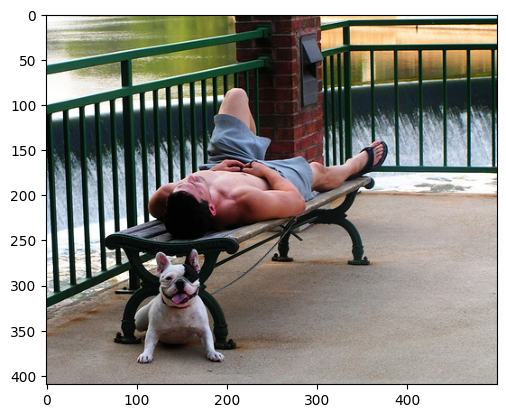

Caption - A man lays on the bench to which a white dog is also tied .
Caption - a man sleeping on a bench outside with a white and black dog sitting next to him .
Caption - A shirtless man lies on a park bench with his dog .
Caption - man laying on bench holding leash of dog sitting on ground
Caption - A man in an orange hat starring at something .


In [14]:
data_idx = 16
image_path = image_data_location + "/" + df.iloc[data_idx,0]
# print( df.iloc[data_idx,:])
img = mpimg.imread(image_path)
plt.imshow(img)
plt.show()

for i in range(data_idx, data_idx+5):
    print(f"Caption - {df.iloc[i,1]}")

In [15]:
import os
from collections import Counter
import spacy
import torch
from torch.nn.utils.rnn import pad_sequence
from torch.utils.data import DataLoader, Dataset
import torchvision.transforms as T

In [16]:
spacy_eng = spacy.load('en_core_web_sm')
text = "This is a good place to find a city"
[token.text.lower() for token in spacy_eng.tokenizer(text)]

['this', 'is', 'a', 'good', 'place', 'to', 'find', 'a', 'city']

# Creating the vacabulary class 

This class creates the actual mapping of the words to its integer and vice-versa. This helps in assiging a numerical value to a word, that can be easily processed by the model.

This class also keeps track of the different words in the "vocabulary" of the model.

In [17]:
class Vocabulary:
    def __init__(self,freq_threshold):
        self.itos = {0:"<PAD>",1:"<SOS>",2:"<EOS>",3:"<UNK>"}
        self.stoi = {v:k for k,v in self.itos.items()}
        self.freq_threshold = freq_threshold
    
    def __len__(self):
        return len(self.itos)
    
    @staticmethod
    def tokenize(text):
        return [token.text.lower() for token in spacy_eng.tokenizer(text)]
    
    def build_vocab(self,sentence_list):
        frequencies = Counter()
        idx = 4
        for sentence in sentence_list:
            for word in self.tokenize(sentence):
                frequencies[word] += 1
                
                if frequencies[word] == self.freq_threshold:
                    self.stoi[word] = idx
                    self.itos[idx] = word
                    idx += 1
    
    def numericalize(self,text):
        tokenized_text = self.tokenize(text)
        return [self.stoi[token] if token in self.stoi else self.stoi["<UNK>"] for token in tokenized_text]
                
                

In [18]:
v = Vocabulary(freq_threshold=1)
v.build_vocab(["This is a new city"])
print(v.stoi)
print(v.numericalize("This is a new city"))

{'<PAD>': 0, '<SOS>': 1, '<EOS>': 2, '<UNK>': 3, 'this': 4, 'is': 5, 'a': 6, 'new': 7, 'city': 8}
[4, 5, 6, 7, 8]


In [19]:
df = pd.read_csv(caption_data_location)
print(df["image"][0][::-1])

gpj.e0bc80b396_1028620001


In [20]:
class CustomDataset(Dataset):
    def __init__(self,root_dir,captions_file,transform=None, freq_threshold=5):
        self.root_dir = root_dir
        self.df = pd.read_csv(captions_file)
        
        self.transform = transform
        self.imgs = self.df["image"]
        self.captions = self.df["caption"]
        
        self.vocab = Vocabulary(freq_threshold)
        self.vocab.build_vocab(self.captions.tolist())
    
    def __len__(self):
        return len(self.df)
    
    def __getitem__(self,idx):
        caption = self.captions[idx]
        img_name = self.imgs[idx]
        
        img_location = os.path.join(self.root_dir,img_name)
        img = Image.open(img_location).convert("RGB")
        
        if self.transform is not None:
            img = self.transform(img)
            
        caption_vec = []
        caption_vec += [self.vocab.stoi["<SOS>"]]
        caption_vec += self.vocab.numericalize(caption)
        caption_vec += [self.vocab.stoi["<EOS>"]]
        
        return img, torch.tensor(caption_vec)

In [21]:
#defing the transform to be applied
transforms = T.Compose([
    T.Resize((224,224)),
    T.ToTensor()
])

In [25]:
def show_image(inp, title=None):
    """Imshow for Tensor"""
    inp = inp.numpy().transpose((1,2,0))
    plt.imshow(inp)
    if title is not None:
        plt.title(title)
    plt.pause(0.001)

In [26]:
# testing the dataset
dataset = CustomDataset(
        root_dir = image_data_location,
        captions_file = train_data_location,
        transform = transforms
)

In [27]:
print(len(dataset))

40000


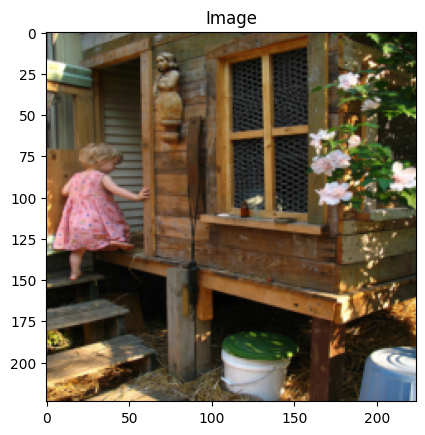

Token : tensor([  1,   4,   7, 316,  76,   4, 157,  74,   5,   2])
Sentence: 
['<SOS>', 'a', 'girl', 'going', 'into', 'a', 'wooden', 'building', '.', '<EOS>']


In [28]:
img, caps = dataset[1]
# print(caps)
show_image(img,"Image")
print("Token :",caps)
print("Sentence: ")
print([dataset.vocab.itos[token] for token in caps.tolist()])

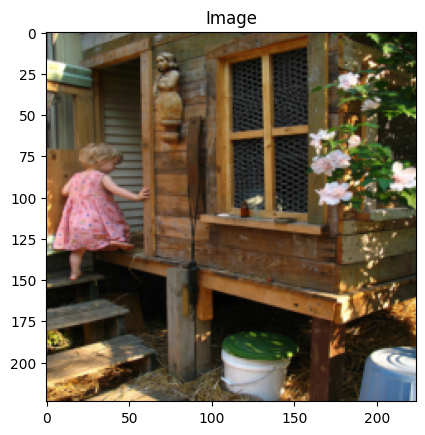

Token : tensor([  1,   4,  28,   8,   4, 195, 151,  17,  32,  67,   4, 353,  11, 711,
          8,  24,   3, 496,   5,   2])
Sentence: 
['<SOS>', 'a', 'child', 'in', 'a', 'pink', 'dress', 'is', 'climbing', 'up', 'a', 'set', 'of', 'stairs', 'in', 'an', '<UNK>', 'way', '.', '<EOS>']


In [29]:
img, caps = dataset[0]
show_image(img,"Image")
print("Token :",caps)
print("Sentence: ")
print([dataset.vocab.itos[token] for token in caps.tolist()])

In [30]:
class CapsCollate:
    def __init__(self,pad_idx,batch_first=False):
        self.pad_idx = pad_idx
        self.batch_first = batch_first
        
    def __call__(self,batch):
        imgs = [item[0].unsqueeze(0) for item in batch]
#         print(f"shape - {(imgs)}")
#         print("----"*22)
        imgs = torch.cat(imgs,dim=0)
#         print(f"shape - {imgs}")
#         print("------")
        targets = [item[1] for item in batch]
        targets = pad_sequence(targets, batch_first=self.batch_first, padding_value=self.pad_idx)
        return imgs,targets

In [31]:
#writing the dataloader
#setting the constants
BATCH_SIZE = 4
NUM_WORKER = 1

#token to represent the padding
pad_idx = dataset.vocab.stoi["<PAD>"]

data_loader = DataLoader(
    dataset=dataset,
    batch_size=BATCH_SIZE,
    num_workers=NUM_WORKER,
    shuffle=True,
    collate_fn=CapsCollate(pad_idx=pad_idx,batch_first=True)
)

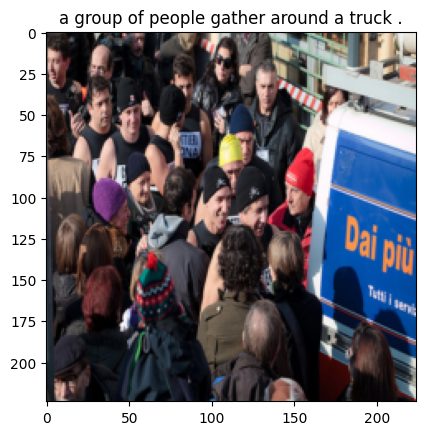

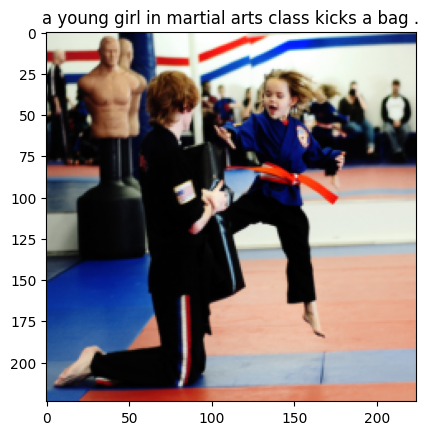

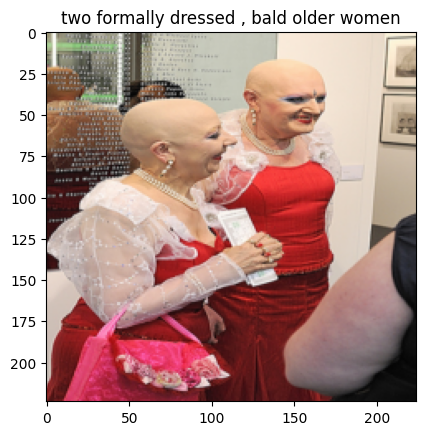

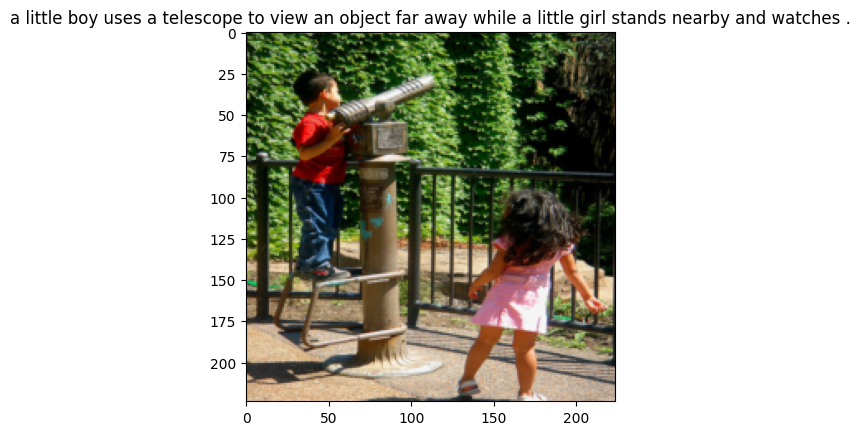

In [32]:
#generating the iterator from the dataloader
dataiter = iter(data_loader)

#getting the next batch
batch = next(dataiter)

#unpacking the batch
images, captions = batch

#showing info of image in single batch
for i in range(BATCH_SIZE):
    img,cap = images[i],captions[i]
#     print(f"captions - {captions[i]}")
    caption_label = [dataset.vocab.itos[token] for token in cap.tolist()]
    eos_index = caption_label.index('<EOS>')
    caption_label = caption_label[1:eos_index]
    caption_label = ' '.join(caption_label)                      
    show_image(img,caption_label)
    plt.show()

In [33]:
import torch
import torch.nn as nn
import torchvision.models as models
import torch.optim as optim

In [ ]:
# vgg16 = models.resnet50(pretrained=True)
# for param in vgg16.parameters():
#     param.requires_grad_(False)
# modules = list(vgg16.children())[:-1]
# print(dir(vgg16))

# ENCODERCNN class 

This class is where the feature extraction model is there. We utilized two feature extractors: **VGG16 **and **resnet50**. There are several others that can also be used. Care must be taken to ensure the output and the input given to the instance of this class as that may cause the feature extractor to either work properly or raise errors. 

Here we are using the resnet50 pretrained model.

# DECODER-RNN class

This class takes in feature extracted by the feature extractor and the captions and returns the outputs. It includes a generate captions function that return the predictd caption of the model.

Here we are using LSTM layer.

In [34]:
class EncoderCNN(nn.Module):
    def __init__(self,embed_size):
        super(EncoderCNN,self).__init__()
        resnet = models.resnet50(pretrained=True)
        for param in resnet.parameters():
            param.requires_grad_(False)
        
        modules = list(resnet.children())[:-1]
        self.resnet = nn.Sequential(*modules)
        self.embed = nn.Linear(resnet.fc.in_features,embed_size)
        
    def forward(self,images):
        features = self.resnet(images)
#         print(f"resenet features shape - {features.shape}")
        features = features.view(features.size(0),-1)
#         print(f"resenet features viewed shape - {features.shape}")
        features = self.embed(features)
#         print(f"resenet features embed shape - {features.shape}")
        return features

class DecoderRNN(nn.Module):
    def __init__(self,embed_size,hidden_size,vocab_size,num_layers=1,drop_prob=0.3):
        super(DecoderRNN,self).__init__()
        self.embedding = nn.Embedding(vocab_size,embed_size)
        self.lstm = nn.LSTM(embed_size,hidden_size,num_layers=num_layers,batch_first=True)
        self.fcn = nn.Linear(hidden_size,vocab_size)
        self.drop = nn.Dropout(drop_prob)
    
    def forward(self,features, captions):
        # vectorize the caption
#         print(f"captions - {captions[:,:-1]}")
#         print(f"caption shape - {captions[:,:-1].shape}")
        embeds = self.embedding(captions[:,:-1])
#         print(f"shape of embeds - {embeds.shape}")
        # concat the features and captions
#         print(f"features shape - {features.shape}")
#         print(f"features unsqueeze at index 1 shape - {features.unsqueeze(1).shape}")
        x = torch.cat((features.unsqueeze(1),embeds),dim=1)
#         print(f"shape of x - {x.shape}")
        x,_ = self.lstm(x)
#         print(f"shape of x after lstm - {x.shape}")
        x = self.fcn(x)
#         print(f"shape of x after fcn - {x.shape}")
        return x
    
    def generate_caption(self,inputs,hidden=None,max_len=20,vocab=None):
        # Inference part
        # Given the image features generate the captions
        
        batch_size = inputs.size(0)
        
        captions = []
        
        for i in range(max_len):
            output,hidden = self.lstm(inputs,hidden)
            output = self.fcn(output)
            output = output.view(batch_size,-1)
        
            
            #select the word with most val
            predicted_word_idx = output.argmax(dim=1)
            
            #save the generated word
            captions.append(predicted_word_idx.item())
            
            #end if <EOS detected>
            if vocab.itos[predicted_word_idx.item()] == "<EOS>":
                break
            
            #send generated word as the next caption
            inputs = self.embedding(predicted_word_idx.unsqueeze(0))
        
        #covert the vocab idx to words and return sentence
        return [vocab.itos[idx] for idx in captions]


class EncoderDecoder(nn.Module):
    def __init__(self,embed_size,hidden_size,vocab_size,num_layers=1,drop_prob=0.3):
        super(EncoderDecoder,self).__init__()
        self.encoder = EncoderCNN(embed_size)
        self.decoder = DecoderRNN(embed_size,hidden_size,vocab_size,num_layers,drop_prob)
    
    def forward(self, images, captions):
        features = self.encoder(images)
        outputs = self.decoder(features, captions)
        return outputs
# resenet features shape - torch.Size([4, 2048, 1, 1])
# resenet features viewed shape - torch.Size([4, 2048])
# resenet features embed shape - torch.Size([4, 400])
# caption shape - torch.Size([4, 14])
# shape of embeds - torch.Size([4, 14, 400])
# features shape - torch.Size([4, 400])
# features unsqueeze at index 1 shape - torch.Size([4, 1, 400])
# shape of x - torch.Size([4, 15, 400])
# shape of x after lstm - torch.Size([4, 15, 512])
# shape of x after fcn - torch.Size([4, 15, 2994])

In [35]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

In [36]:
# Hyperparameters
embed_size = 400
hidden_size = 512
vocab_size = len(dataset.vocab)
num_layers = 2
learning_rate = 0.0001
num_epochs = 2

In [37]:
# initialize model, loss etc
model = EncoderDecoder(embed_size, hidden_size, vocab_size, num_layers).to(device)
criterion = nn.CrossEntropyLoss(ignore_index=dataset.vocab.stoi["<PAD>"])
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 241MB/s]


Set the num_epochs to 20.

Technically, image caption models are trained for many more epochs, however due to resource(compute units) constraints of the Google Colab, we are limiting the model training to only this many epochs.

For 20 epochs the model took about ~3 hrs.

# Model Training

Epoch: 1 loss: 3.94920 iter:4000
features shape - torch.Size([1, 400])
<SOS> a man in a red shirt and a red shirt is sitting on a <UNK> . <EOS>


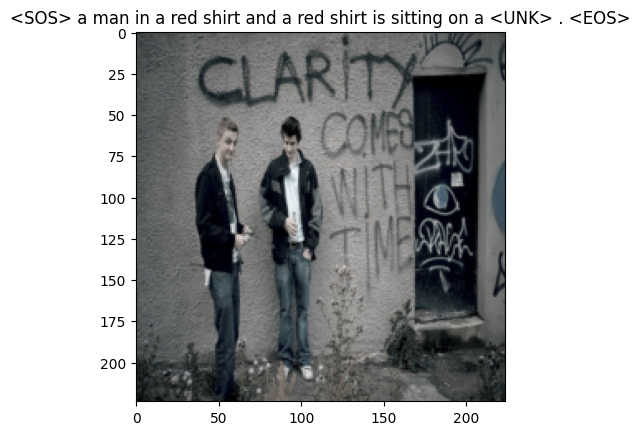

Epoch: 1 loss: 3.29764 iter:8000
features shape - torch.Size([1, 400])
<SOS> a dog is running through the grass . <EOS>


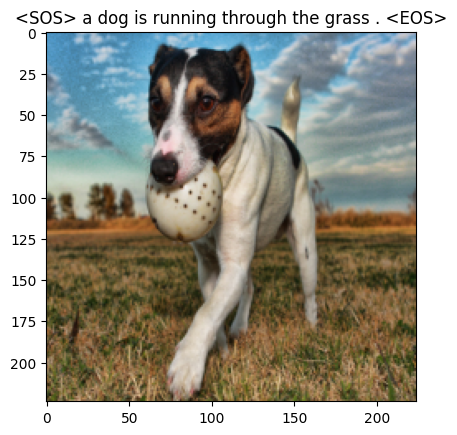

Epoch: 2 loss: 2.84856 iter:4000
features shape - torch.Size([1, 400])
<SOS> a black and white dog is running through the grass . <EOS>


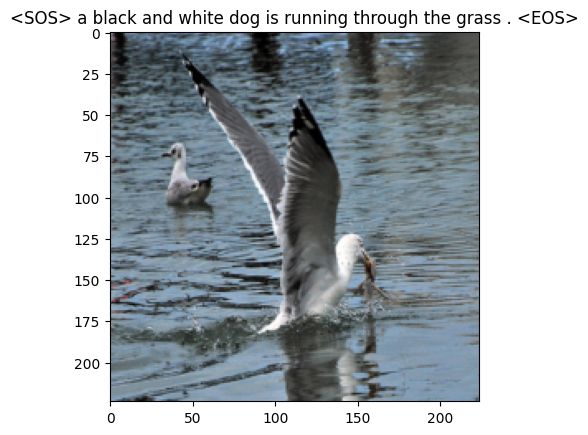

Epoch: 2 loss: 2.47399 iter:8000
features shape - torch.Size([1, 400])
<SOS> a black and white dog is running through the grass . <EOS>


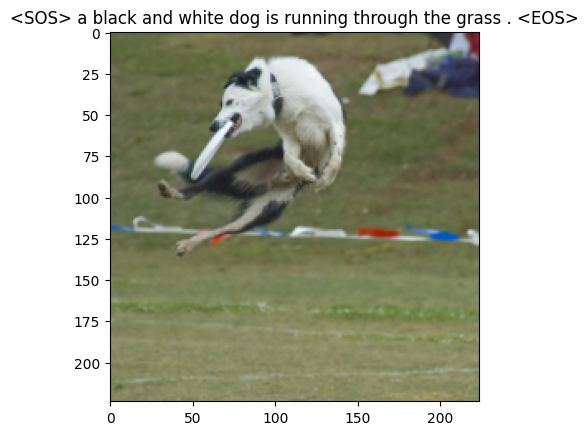

Epoch: 3 loss: 2.71448 iter:4000
features shape - torch.Size([1, 400])
<SOS> a black dog is running through the snow . <EOS>


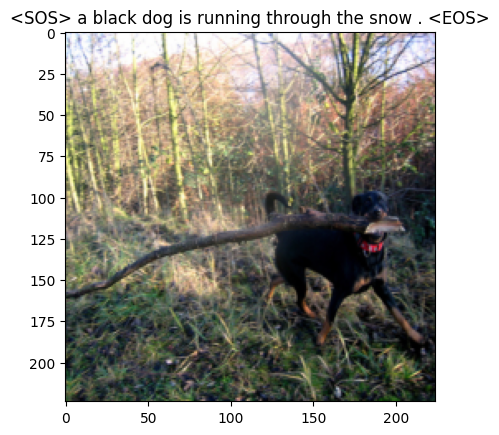

Epoch: 3 loss: 2.37392 iter:8000
features shape - torch.Size([1, 400])
<SOS> a group of people are standing in front of a building . <EOS>


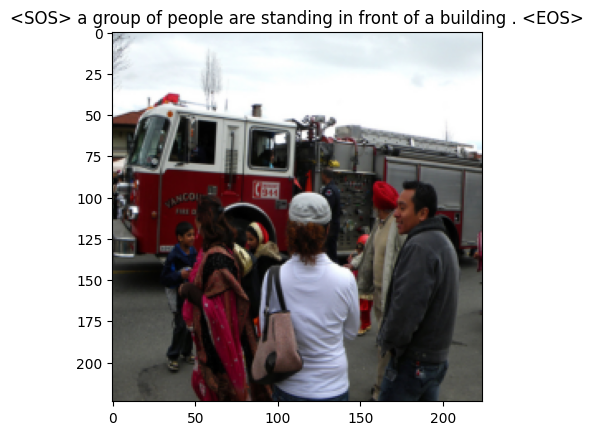

Epoch: 4 loss: 2.55471 iter:4000
features shape - torch.Size([1, 400])
<SOS> a man in a red shirt and a black hat is sitting on a bench . <EOS>


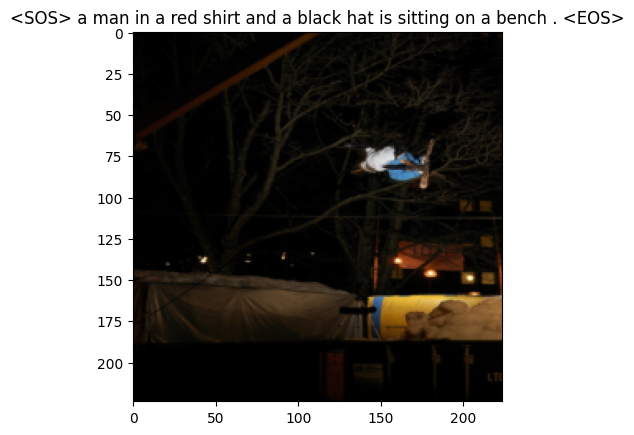

Epoch: 4 loss: 1.93413 iter:8000
features shape - torch.Size([1, 400])
<SOS> a white dog with a red collar is running on a grassy field . <EOS>


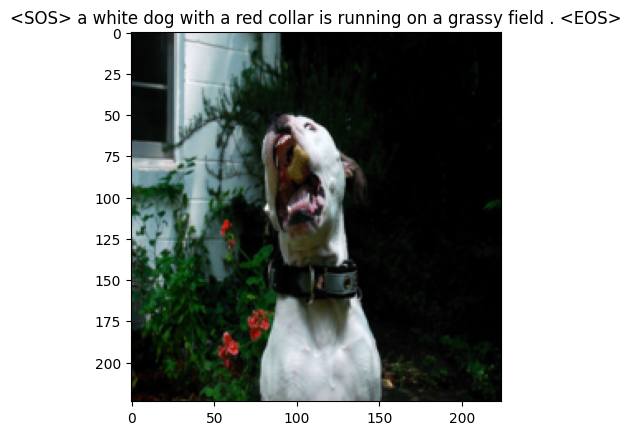

Epoch: 5 loss: 2.73530 iter:4000
features shape - torch.Size([1, 400])
<SOS> a dog is running through the grass . <EOS>


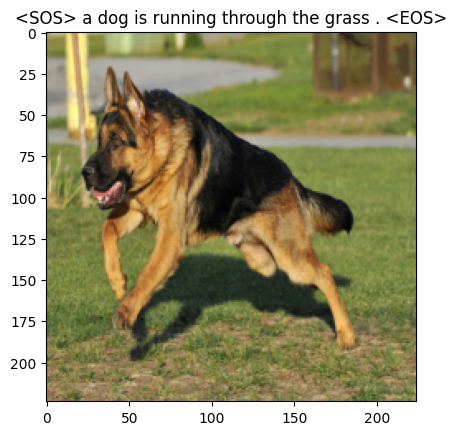

Epoch: 5 loss: 2.01332 iter:8000
features shape - torch.Size([1, 400])
<SOS> a man in a blue shirt is riding a bike on a dirt path . <EOS>


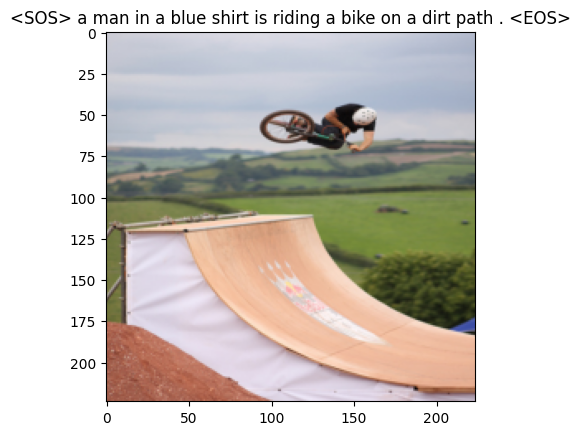

Epoch: 6 loss: 2.78916 iter:4000
features shape - torch.Size([1, 400])
<SOS> a little girl in a pink dress is running through a grassy area . <EOS>


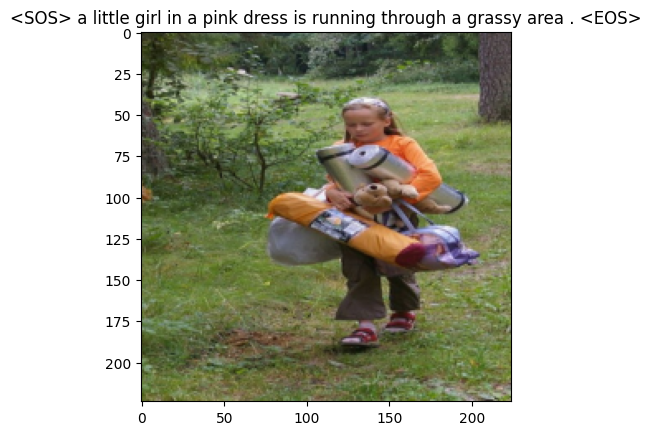

Epoch: 6 loss: 1.77644 iter:8000
features shape - torch.Size([1, 400])
<SOS> a boy in a red shirt is jumping off a swing . <EOS>


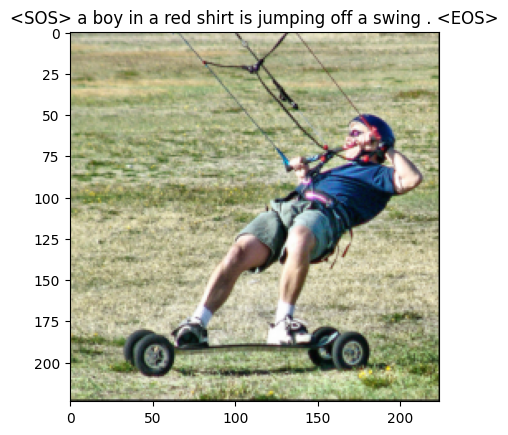

Epoch: 7 loss: 2.01064 iter:4000
features shape - torch.Size([1, 400])
<SOS> a dog with a red collar is standing in front of a tree . <EOS>


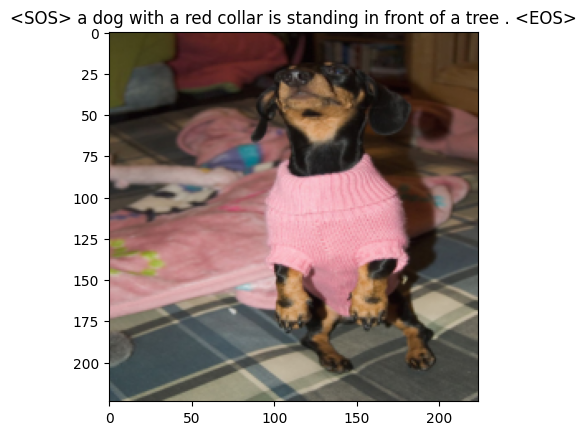

Epoch: 7 loss: 2.19025 iter:8000
features shape - torch.Size([1, 400])
<SOS> a man climbing a rock face . <EOS>


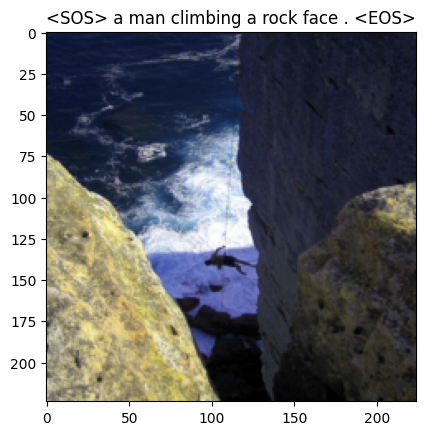

Epoch: 8 loss: 1.94908 iter:4000
features shape - torch.Size([1, 400])
<SOS> a man is standing on a rocky shore . <EOS>


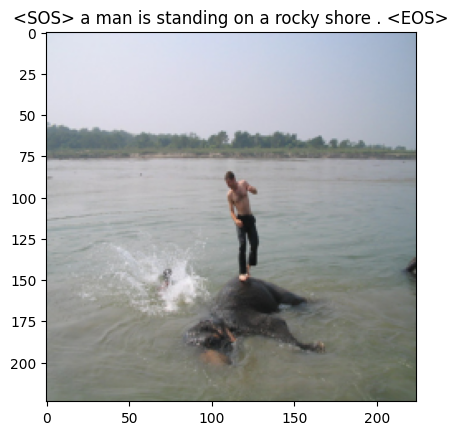

Epoch: 8 loss: 2.06862 iter:8000
features shape - torch.Size([1, 400])
<SOS> a man in a white shirt and blue shorts is holding a basketball in a basketball court . <EOS>


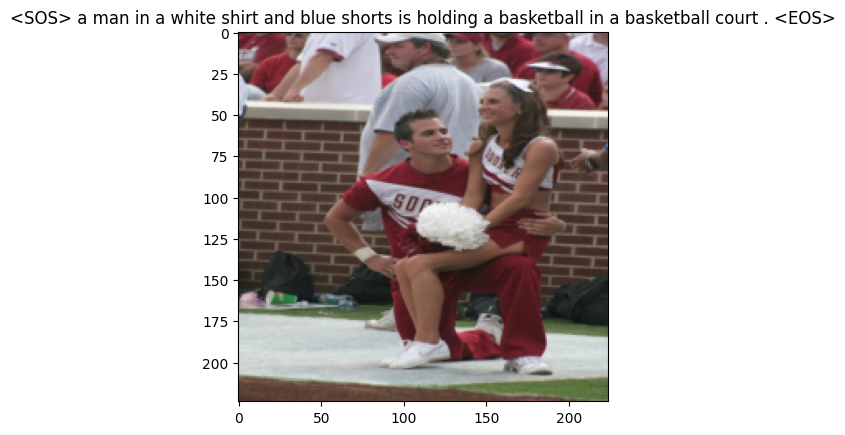

Epoch: 9 loss: 2.30052 iter:4000
features shape - torch.Size([1, 400])
<SOS> a boy in a blue shirt is jumping off a ramp . <EOS>


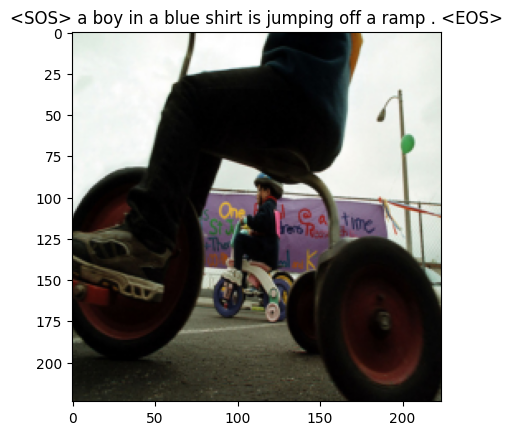

Epoch: 9 loss: 2.29417 iter:8000
features shape - torch.Size([1, 400])
<SOS> a soccer player in a red uniform is running with the ball . <EOS>


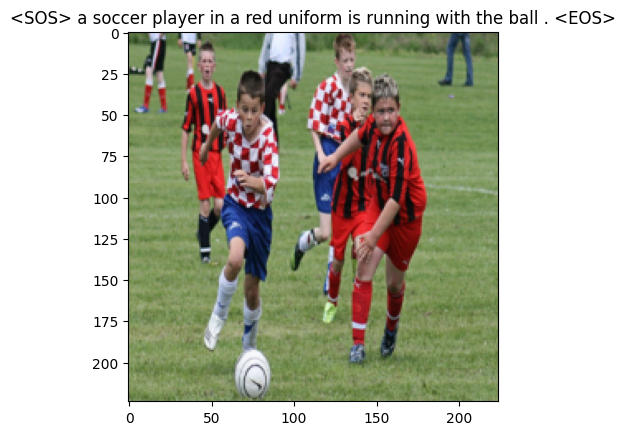

Epoch: 10 loss: 1.76986 iter:4000
features shape - torch.Size([1, 400])
<SOS> a man wearing a red hat and sunglasses looks at the camera . <EOS>


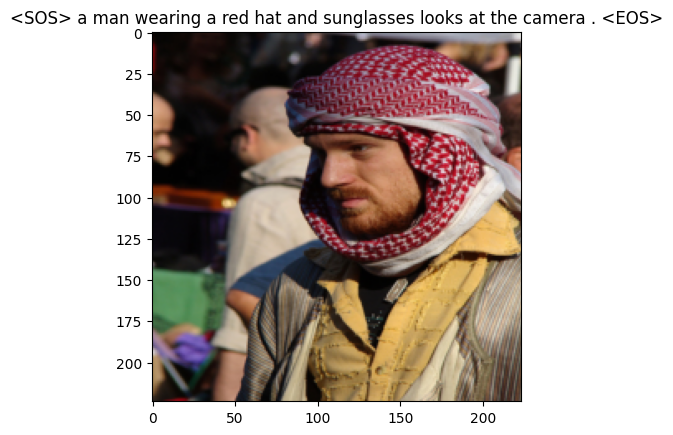

Epoch: 10 loss: 1.77974 iter:8000
features shape - torch.Size([1, 400])
<SOS> a group of people are standing in a field . <EOS>


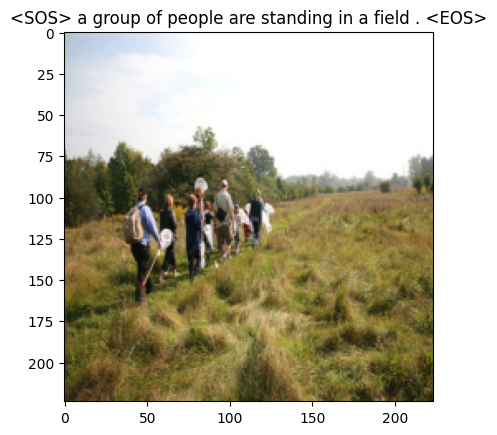

Epoch: 11 loss: 1.98791 iter:4000
features shape - torch.Size([1, 400])
<SOS> a dog runs through a field . <EOS>


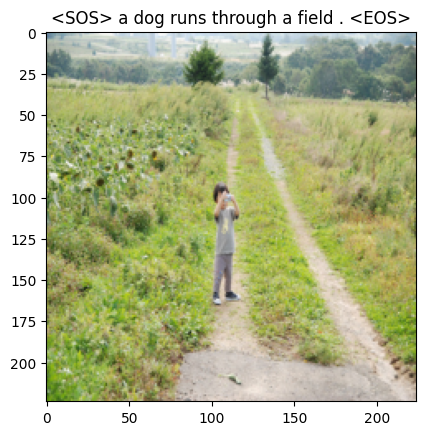

Epoch: 11 loss: 1.63903 iter:8000
features shape - torch.Size([1, 400])
<SOS> a dog is running on the grass . <EOS>


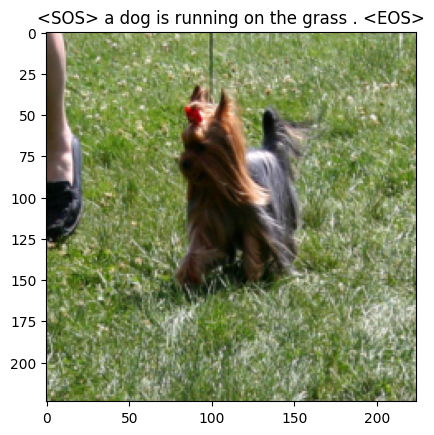

Epoch: 12 loss: 1.31246 iter:4000
features shape - torch.Size([1, 400])
<SOS> a man is standing on a grassy hill with a dog in the background . <EOS>


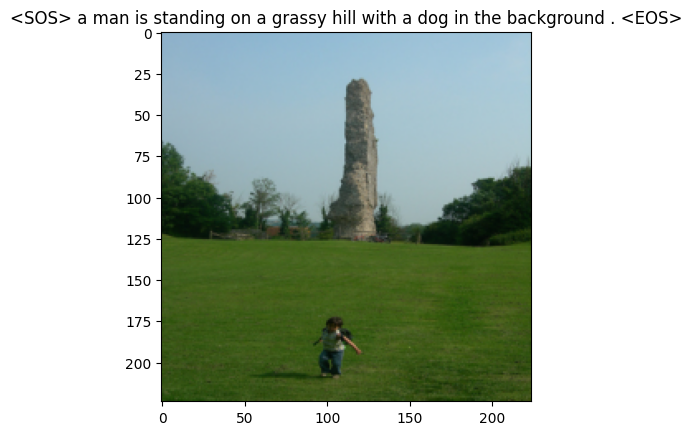

Epoch: 12 loss: 1.10934 iter:8000
features shape - torch.Size([1, 400])
<SOS> a man is rollerblading down a railing beside a railing . <EOS>


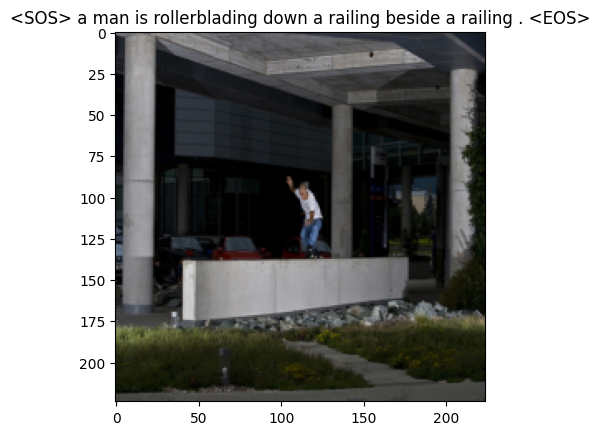

Epoch: 13 loss: 1.55268 iter:4000
features shape - torch.Size([1, 400])
<SOS> a baby in a red shirt is holding a basket of <UNK> and a boy in a blue shirt


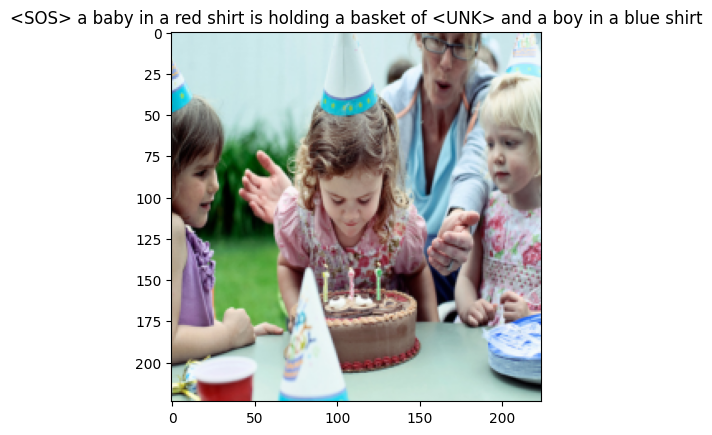

Epoch: 13 loss: 1.76997 iter:8000
features shape - torch.Size([1, 400])
<SOS> a man in a red shirt is jumping his skateboard over a ramp . <EOS>


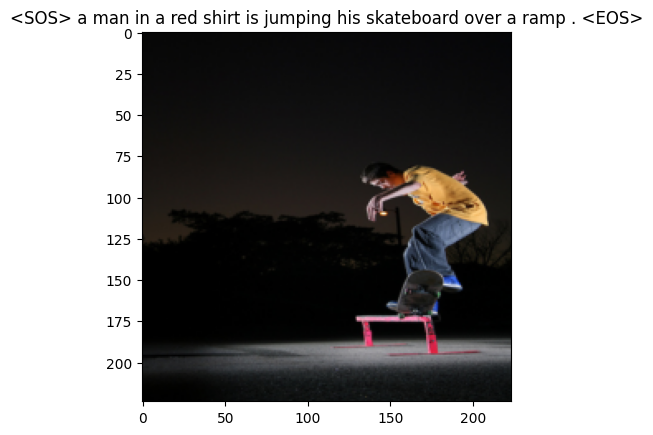

Epoch: 14 loss: 1.68051 iter:4000
features shape - torch.Size([1, 400])
<SOS> a group of people are standing in the street at a carnival . <EOS>


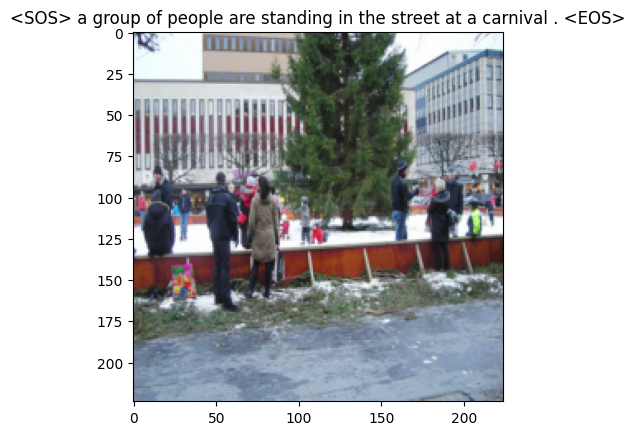

Epoch: 14 loss: 1.57399 iter:8000
features shape - torch.Size([1, 400])
<SOS> a brown dog is running through a grassy area . <EOS>


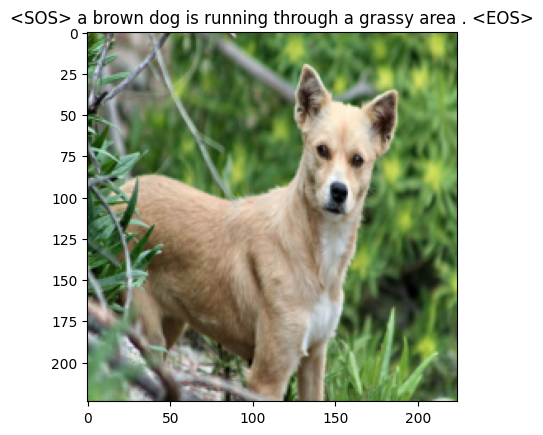

Epoch: 15 loss: 1.58807 iter:4000
features shape - torch.Size([1, 400])
<SOS> a basketball player dribbles the ball . <EOS>


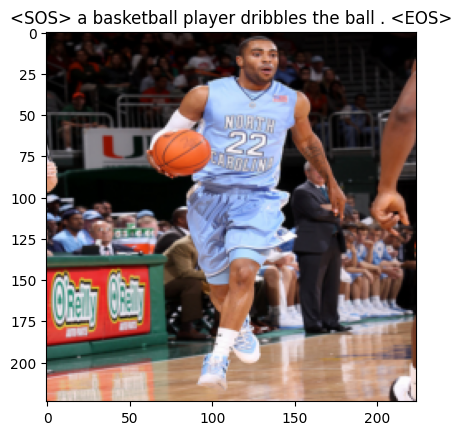

Epoch: 15 loss: 1.26069 iter:8000
features shape - torch.Size([1, 400])
<SOS> two dogs are running on the sand . <EOS>


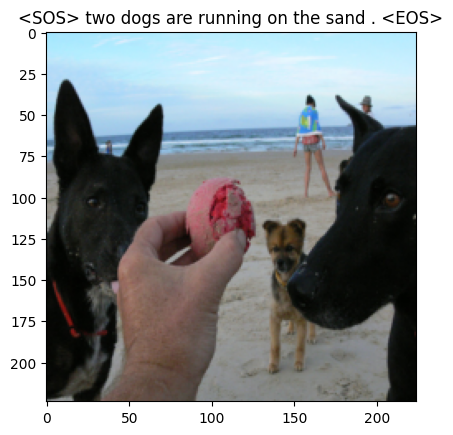

Epoch: 16 loss: 1.17224 iter:4000
features shape - torch.Size([1, 400])
<SOS> a man is standing on a sidewalk with a lot of people around him . <EOS>


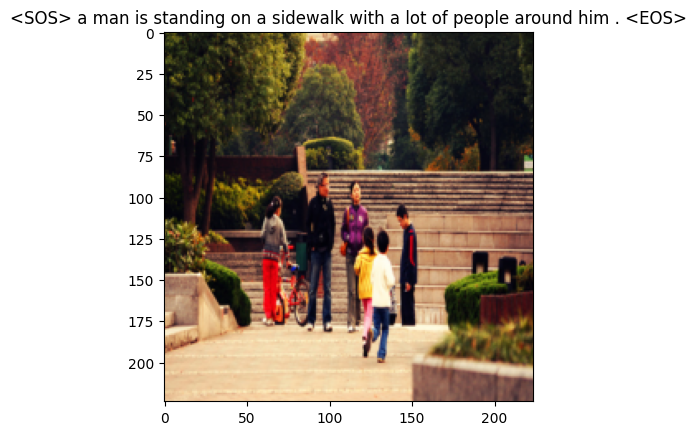

Epoch: 16 loss: 1.15964 iter:8000
features shape - torch.Size([1, 400])
<SOS> a baby is sitting in the grass with a blue and white cup in his mouth . <EOS>


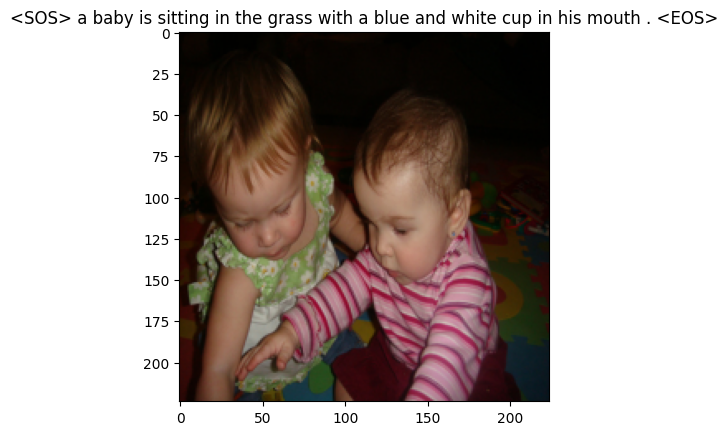

Epoch: 17 loss: 1.02365 iter:4000
features shape - torch.Size([1, 400])
<SOS> a dog running through the snow . <EOS>


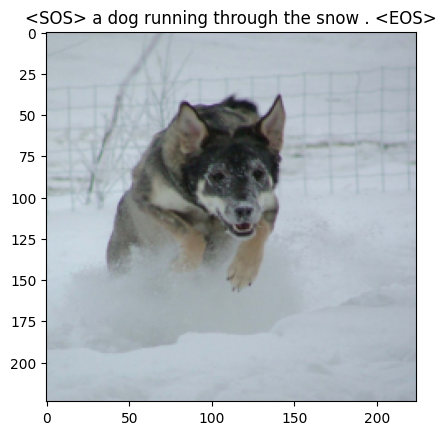

Epoch: 17 loss: 1.52298 iter:8000
features shape - torch.Size([1, 400])
<SOS> a woman is sitting on a bench in a park . <EOS>


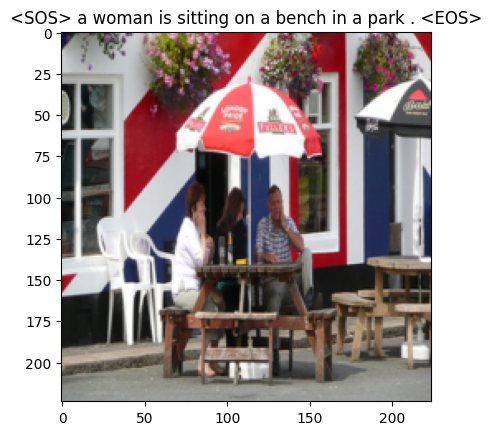

Epoch: 18 loss: 1.32672 iter:4000
features shape - torch.Size([1, 400])
<SOS> a man in a white shirt is standing in a field holding a green football and a stick .


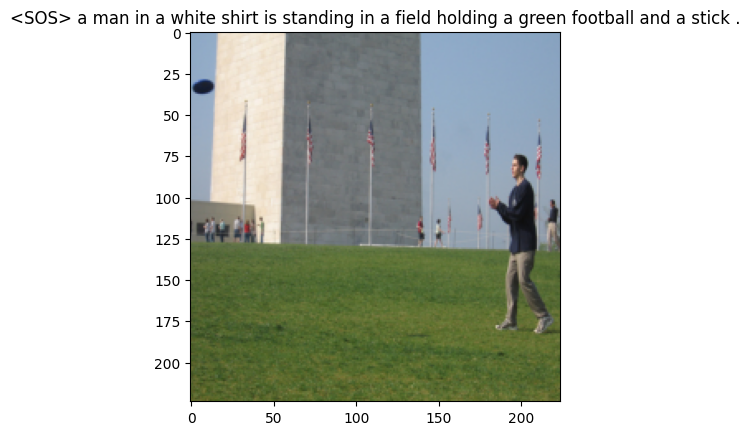

Epoch: 18 loss: 1.29116 iter:8000
features shape - torch.Size([1, 400])
<SOS> a surfer rides the waves . <EOS>


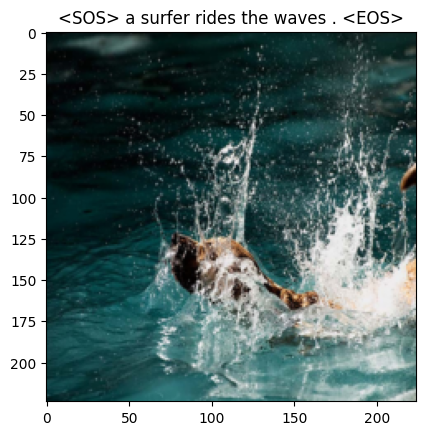

Epoch: 19 loss: 1.09204 iter:4000
features shape - torch.Size([1, 400])
<SOS> a man is sitting on a boat with a fishing pole and it is in the air with a


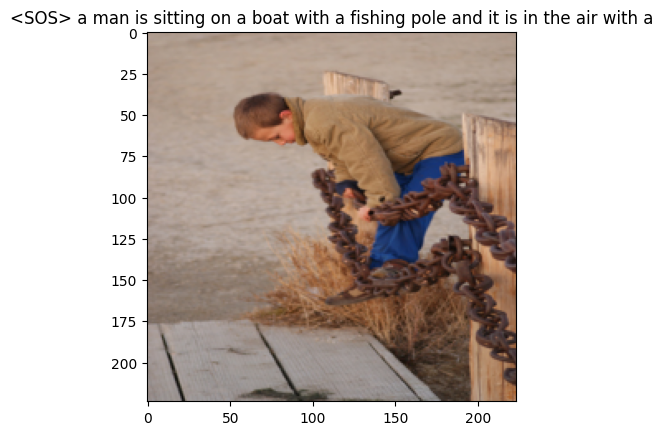

Epoch: 19 loss: 1.12294 iter:8000
features shape - torch.Size([1, 400])
<SOS> a young girl is blowing bubbles with a bubble wand in the garden . <EOS>


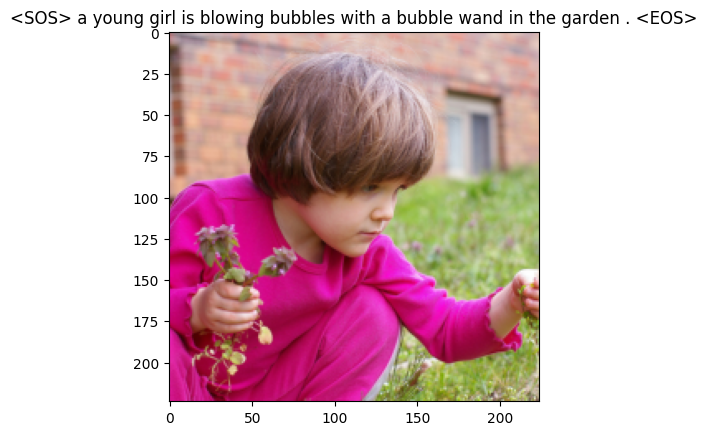

Epoch: 20 loss: 1.05770 iter:4000
features shape - torch.Size([1, 400])
<SOS> a woman with a red headband is holding a camera . <EOS>


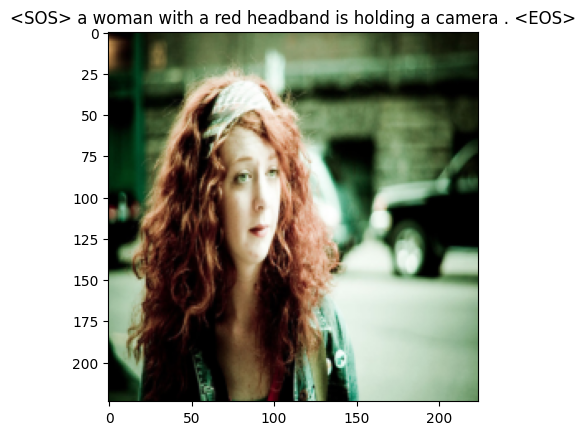

Epoch: 20 loss: 1.14860 iter:8000
features shape - torch.Size([1, 400])
<SOS> a group of people are riding bicycles on a race . <EOS>


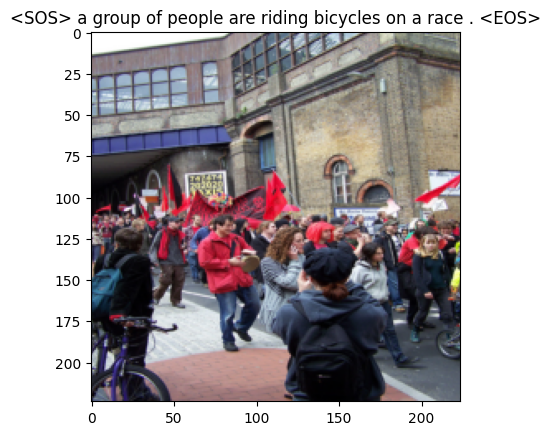

In [38]:
num_epochs = 20
print_every = 4000


for epoch in range(1,num_epochs+1):   
    for idx, (image, captions) in (enumerate(iter(data_loader))):
        image,captions = image.to(device),captions.to(device)

        # Zero the gradients.
        optimizer.zero_grad()

        # Feed forward
        outputs = model(image, captions)
        
        # Calculate the batch loss.
        loss = criterion(outputs.view(-1, vocab_size), captions.view(-1))

        
        # Backward pass.
        loss.backward()

        # Update the parameters in the optimizer.
        optimizer.step()

        writer.add_scalar("Training loss/epoch", loss.item(), global_step = idx)
        
        if (idx+1)%print_every == 0:
            print("Epoch: {} loss: {:.5f} iter:{}".format(epoch,loss.item(),idx+1))

            
            
            #generate the caption
            model.eval()
            with torch.no_grad():
                dataiter = iter(data_loader)
                img,_ = next(dataiter)
                features = model.encoder(img[0:1].to(device))
                print(f"features shape - {features.shape}")
                caps = model.decoder.generate_caption(features.unsqueeze(0),vocab=dataset.vocab)
                caption = ' '.join(caps)
                print(caption)
                show_image(img[0],title=caption)
                
            model.train()



Using the Tensorboard for Scalars and setting the horizontal axis as steps doesn't provides a good understanding of the model. However, by changing the horizonrtal axis to relative and/or to wall assists in better understanding of the model.

### The reason it doesn't works good for step, is due to the fact that for ***each epoch*** the model is getting trained for ***10,000 steps.*** 

And by setting the horizontal axis as **step** we see the loses for all the 20 epochs as well. 

Thus, going relative and/or wall shows much better.

Another way to get the same thing but for step is to create a new variable steps that keeps on increasing by +1 at each cycle and simply, setting the `global_step = steps` before starting the training loop as follows:



```
writer.add_scalar("Training loss/epoch", loss.item(), global_step = steps)
steps+=1
```

steps is initialised before the outer epoch loop

In [39]:
%load_ext tensorboard
%tensorboard --logdir /content/resnet_lstm --port 8088

<IPython.core.display.Javascript object>

# Testing the model

In this step we take a random image from the testing sample( size : 455), find its generated caption and then find the bleu-scores by comparing the original/human captions to the generated/predicted caption. **bold text**

In [40]:
import random
import pandas as pd
def testing():
  img_no = random.randrange(0,455,5)
  test_data_df = pd.read_csv(test_data_location)
  img_name = test_data_df['image'][img_no]
  original = test_data_df[test_data_df['image'] == img_name]['caption'].tolist()
  ref = []
  for i in original:
    ref.append([token.text.lower() for token in spacy_eng.tokenizer(i)])
  
  print('image_name : \t', img_name)
  print('original_captions: \t', original)
  print('references to be passed: \t', ref)
  model.eval()
  with torch.no_grad():
    img_location = os.path.join(image_data_location,img_name)
    img = Image.open(img_location).convert("RGB")
    transformed_image = transforms(img)
    show_image(transformed_image)
    features = model.encoder(transformed_image.unsqueeze(0).to(device))
    caps = model.decoder.generate_caption(features.unsqueeze(0), vocab = dataset.vocab)
    _1,_2,_3,_4 = bleu_score(ref, caps)
    return _1, _2, _3, _4



# Finding the bleu scores

In [43]:
from nltk.translate.bleu_score import SmoothingFunction
smoothie = SmoothingFunction().method4
def bleu_score(original_captions, generated_caption):
  #generated_caption.remove('<SOS>')
  #generated_caption.remove('<EOS>')
  print('BLEU Scores :')
  print('A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.')
  b_1 = sentence_bleu(original_captions, generated_caption, weights=(1.0, 0, 0, 0))
  b_2 = sentence_bleu(original_captions, generated_caption, weights=(0.5, 0.5, 0, 0))
  b_3 = sentence_bleu(original_captions, generated_caption, weights=(0.3, 0.3, 0.3, 0), smoothing_function  = smoothie)
  b_4 = sentence_bleu(original_captions, generated_caption, weights=(0.25, 0.25, 0.25, 0.25), smoothing_function = smoothie)

  print("\ngenerated-caption : \t" , ' '.join(generated_caption))

  print('BLEU-1: %f' % b_1)
  print('BLEU-2: %f' % b_2)
  print('BLEU-3: %f' % b_3)
  print('BLEU-4: %f' % b_4)

  return b_1, b_2, b_3, b_4

# FInding the average bleu-scores of 10 random samples(images) from the testing data.


*****NEW_INPUT*******



image_name : 	 97577988_65e2eae14a.jpg
original_captions: 	 ['A man mountain climbing up an icy mountain .', 'An climber is ascending an ice covered rock face .', 'A person in orange climbs a sheer cliff face covered in snow and ice .', 'Person in a yellow jacket is climbing up snow covered rocks .', 'There is a climber scaling a snowy mountainside .']
references to be passed: 	 [['a', 'man', 'mountain', 'climbing', 'up', 'an', 'icy', 'mountain', '.'], ['an', 'climber', 'is', 'ascending', 'an', 'ice', 'covered', 'rock', 'face', '.'], ['a', 'person', 'in', 'orange', 'climbs', 'a', 'sheer', 'cliff', 'face', 'covered', 'in', 'snow', 'and', 'ice', '.'], ['person', 'in', 'a', 'yellow', 'jacket', 'is', 'climbing', 'up', 'snow', 'covered', 'rocks', '.'], ['there', 'is', 'a', 'climber', 'scaling', 'a', 'snowy', 'mountainside', '.']]


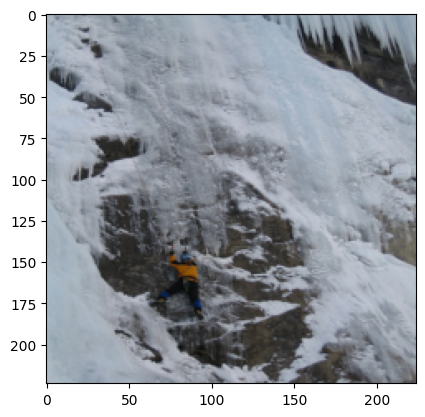

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 <SOS> a man is standing on top of a mountain . <EOS>
BLEU-1: 0.500000
BLEU-2: 0.301511
BLEU-3: 0.160759
BLEU-4: 0.074729

*****NEW_INPUT*******



image_name : 	 979383193_0a542a059d.jpg
original_captions: 	 ['A group of six children sit at a wooden table .', 'A group of young asian children pose for a picture at a table .', 'Six children , all with black hair , sit at a table for a picture .', 'Six children at a table .', 'Six small children sitting at a desk .']
references to be passed: 	 [['a', 'group', 'of', 'six', 'children', 'sit', 'at', 'a', 'wooden', 'table', '.'], ['a', 'group', 'of', 'young', 'asian', 'children', 'pose', 'for', 'a', 'picture', 'at', 'a', 'table', '.'], ['six', 'children', ',', 'all', 'with', 'black', 'hair', ',', 'sit', 'at', 'a', 'table', 'for', 'a', 'picture', '.'], ['six', 'children', 'at', 'a', 'table', '.'], ['six', 'small

/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)


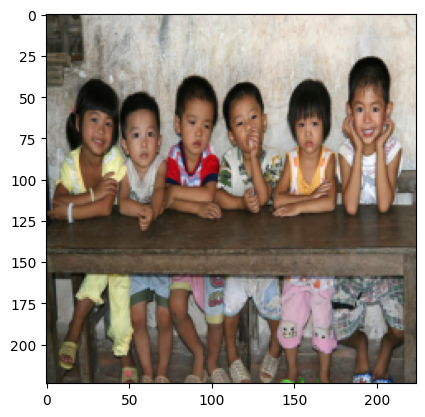

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 <SOS> four children are sitting on the edge of a cement wall . <EOS>
BLEU-1: 0.357143
BLEU-2: 0.000000
BLEU-3: 0.058949
BLEU-4: 0.026296

*****NEW_INPUT*******



image_name : 	 957230475_48f4285ffe.jpg
original_captions: 	 ["A boy licks an older male 's face that 's covered in a blue and yellow creamy substance .", 'A child in a yellow shirt is licking brightly colored food off of a mans cheek .', "A young boy is licking blue and yellow frosting off a young man 's face .", "A young boy is licking colored frosting off a young man 's face .", 'Someone licks the face of a man with blue and yellow paint on his face .']
references to be passed: 	 [['a', 'boy', 'licks', 'an', 'older', 'male', "'s", 'face', 'that', "'s", 'covered', 'in', 'a', 'blue', 'and', 'yellow', 'creamy', 'substance', '.'], ['a', 'child', 'in', 'a', 'yellow', 'shirt', 'is', 'licking', 'br

/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_

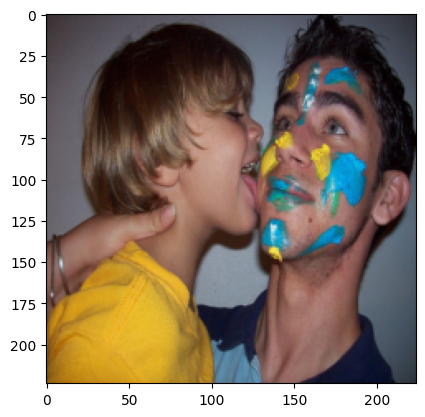

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 <SOS> a baby with a <UNK> on his face . <EOS>
BLEU-1: 0.484464
BLEU-2: 0.332636
BLEU-3: 0.295012
BLEU-4: 0.205441

*****NEW_INPUT*******



image_name : 	 905355838_3a43fdfd4e.jpg
original_captions: 	 ['A baseball player standing on the field', 'a baseball player stands and faces the crowd .', 'A baseball player wearing a number 19 shirt looks at the outfield .', 'A male ballplayer wearing a white and blue uniform playing in front of a large crowd .', 'Baseball player looking out into a stadium crowd']
references to be passed: 	 [['a', 'baseball', 'player', 'standing', 'on', 'the', 'field'], ['a', 'baseball', 'player', 'stands', 'and', 'faces', 'the', 'crowd', '.'], ['a', 'baseball', 'player', 'wearing', 'a', 'number', '19', 'shirt', 'looks', 'at', 'the', 'outfield', '.'], ['a', 'male', 'ballplayer', 'wearing', 'a', 'white', 'and', 'blue', 'uniform', 'pl

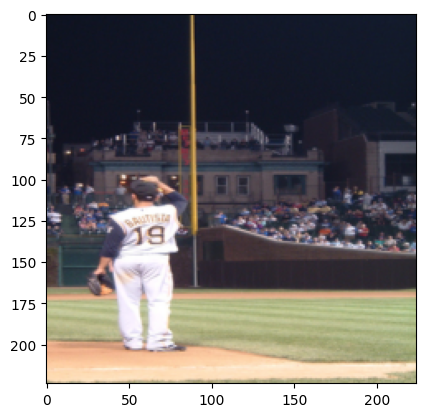

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 <SOS> a baseball player <UNK> to throw the ball . <EOS>
BLEU-1: 0.454545
BLEU-2: 0.301511
BLEU-3: 0.251947
BLEU-4: 0.131910

*****NEW_INPUT*******



image_name : 	 961189263_0990f3bcb5.jpg
original_captions: 	 ['A child is playing in the muddy water running along a grassy area .', 'A little boy is sitting on a wet path covered in mud .', 'A small boy sits in a mud puddle and gets covered with mud .', 'a very dirty young blond boy playing in the mud .', 'The little kid sits down in the muddy water .']
references to be passed: 	 [['a', 'child', 'is', 'playing', 'in', 'the', 'muddy', 'water', 'running', 'along', 'a', 'grassy', 'area', '.'], ['a', 'little', 'boy', 'is', 'sitting', 'on', 'a', 'wet', 'path', 'covered', 'in', 'mud', '.'], ['a', 'small', 'boy', 'sits', 'in', 'a', 'mud', 'puddle', 'and', 'gets', 'covered', 'with', 'mud', '.'], ['a', 'very', 'dir

/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)


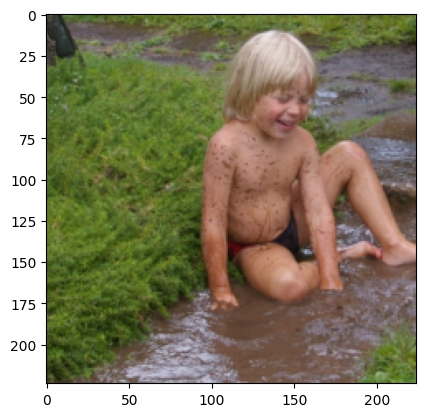

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 <SOS> a boy in a pool . <EOS>
BLEU-1: 0.486750
BLEU-2: 0.232711
BLEU-3: 0.137594
BLEU-4: 0.069752

*****NEW_INPUT*******



image_name : 	 909191414_1cf5d85821.jpg
original_captions: 	 ['A boy is leaping over a blue hose pipe as a little girl watches .', 'A boy is leaping while his sister plays around a hose .', 'A young boy jumping in front of a young girl and a house .', 'Children are playing in and around a garden tube in the front yard of a house .', 'Two children playing above a blue water hose .']
references to be passed: 	 [['a', 'boy', 'is', 'leaping', 'over', 'a', 'blue', 'hose', 'pipe', 'as', 'a', 'little', 'girl', 'watches', '.'], ['a', 'boy', 'is', 'leaping', 'while', 'his', 'sister', 'plays', 'around', 'a', 'hose', '.'], ['a', 'young', 'boy', 'jumping', 'in', 'front', 'of', 'a', 'young', 'girl', 'and', 'a', 'house', '.'], ['children', 'are',

/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)


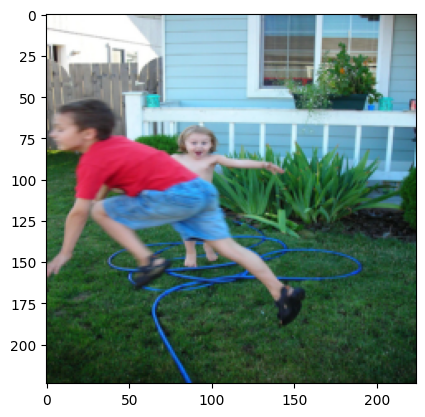

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 <SOS> a little boy in a red shirt and a little girl in a red shirt are playing with a
BLEU-1: 0.550000
BLEU-2: 0.340279
BLEU-3: 0.220049
BLEU-4: 0.103184

*****NEW_INPUT*******



image_name : 	 94232465_a135df2711.jpg
original_captions: 	 ['A lady ice skates while pulling a child in a buggy .', 'A mother pulls her daughter in a wagon over a snowy plain .', 'A woman pulling a wagon with a girl in it across a frozen lake', 'The girl pulls a toddler in a cart while skating on the ice .', 'The woman is ice skating and pulling the little girl in the cart across the ice .']
references to be passed: 	 [['a', 'lady', 'ice', 'skates', 'while', 'pulling', 'a', 'child', 'in', 'a', 'buggy', '.'], ['a', 'mother', 'pulls', 'her', 'daughter', 'in', 'a', 'wagon', 'over', 'a', 'snowy', 'plain', '.'], ['a', 'woman', 'pulling', 'a', 'wagon', 'with', 'a', 'girl', 'in', 'it

/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)


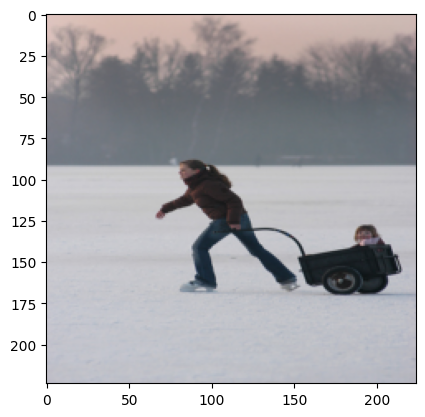

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 <SOS> a man in a yellow jacket is walking on the beach carrying a surfboard . <EOS>
BLEU-1: 0.470588
BLEU-2: 0.242536
BLEU-3: 0.129934
BLEU-4: 0.057905

*****NEW_INPUT*******



image_name : 	 96985174_31d4c6f06d.jpg
original_captions: 	 ['A hiker is walking along a path at the foot of some snowcapped mountains .', 'A man walks near mountains .', 'A man with ski poles stands in front of a mountain .', 'The person is walking in the mountains .', 'The skier is looking at the snowcapped mountains .']
references to be passed: 	 [['a', 'hiker', 'is', 'walking', 'along', 'a', 'path', 'at', 'the', 'foot', 'of', 'some', 'snowcapped', 'mountains', '.'], ['a', 'man', 'walks', 'near', 'mountains', '.'], ['a', 'man', 'with', 'ski', 'poles', 'stands', 'in', 'front', 'of', 'a', 'mountain', '.'], ['the', 'person', 'is', 'walking', 'in', 'the', 'mountains', '.'], ['the'

/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)


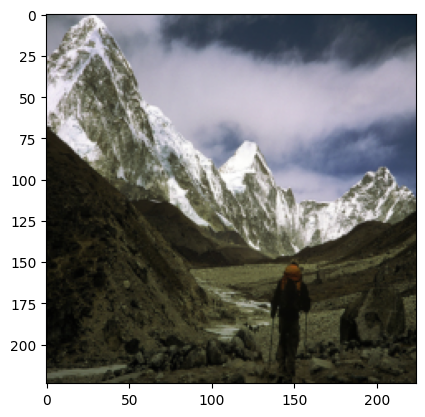

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 <SOS> a man is climbing up a rock while another man watches him from behind . <EOS>
BLEU-1: 0.294118
BLEU-2: 0.135582
BLEU-3: 0.091659
BLEU-4: 0.043294

*****NEW_INPUT*******



image_name : 	 974924582_10bed89b8d.jpg
original_captions: 	 ['A child is running away from a plastic pool and an adult on a rural setting .', 'A child is running away from a woman standing by a paddling pool .', 'A child playing with a water hose while a woman records with a camcorder', 'A woman and her son are playing outside by a kiddie pool .', 'A woman watches a child play near a small pool .']
references to be passed: 	 [['a', 'child', 'is', 'running', 'away', 'from', 'a', 'plastic', 'pool', 'and', 'an', 'adult', 'on', 'a', 'rural', 'setting', '.'], ['a', 'child', 'is', 'running', 'away', 'from', 'a', 'woman', 'standing', 'by', 'a', 'paddling', 'pool', '.'], ['a', 'child', 

/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)


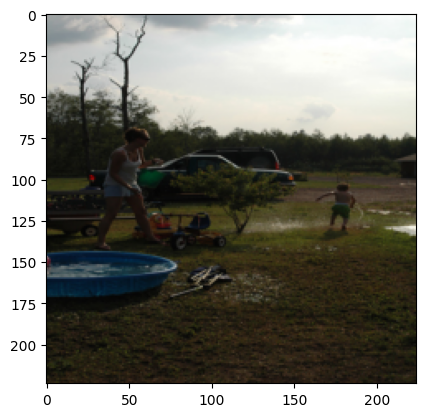

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 <SOS> a man is <UNK> down a hill with his hands in the air . <EOS>
BLEU-1: 0.293567
BLEU-2: 0.000000
BLEU-3: 0.050127
BLEU-4: 0.022076

*****NEW_INPUT*******



image_name : 	 895502702_5170ada2ee.jpg
original_captions: 	 ['A black and white dog is chasing a ball on an open plane .', 'A black and white dog is running through a grassy area .', 'A black and white dog runs on a dry , yellow field of grass .', 'A dog is running towards a ball .', 'A dog runs through a field chasing a ball .']
references to be passed: 	 [['a', 'black', 'and', 'white', 'dog', 'is', 'chasing', 'a', 'ball', 'on', 'an', 'open', 'plane', '.'], ['a', 'black', 'and', 'white', 'dog', 'is', 'running', 'through', 'a', 'grassy', 'area', '.'], ['a', 'black', 'and', 'white', 'dog', 'runs', 'on', 'a', 'dry', ',', 'yellow', 'field', 'of', 'grass', '.'], ['a', 'dog', 'is', 'running', 'toward

/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_

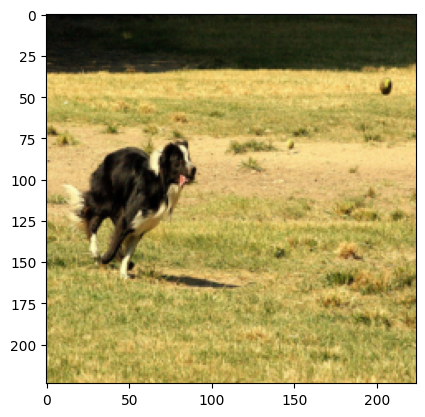

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 <SOS> two dogs run through a field . <EOS>
BLEU-1: 0.444444
BLEU-2: 0.333333
BLEU-3: 0.288535
BLEU-4: 0.155273

****FINDING AVERAGE SCORES****

Average_BLEU-1_score_for_the_above_printed_images: 0.433562
Average_BLEU-2_score_for_the_above_printed_images: 0.222010
Average_BLEU-3_score_for_the_above_printed_images: 0.168456
Average_BLEU-4_score_for_the_above_printed_images: 0.088986


/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)


In [50]:
b_1 = []
b_2 = []
b_3 = []
b_4 = []
for i in range(10):
  print('\n*****NEW_INPUT*******\n')
  print('\n')
  _1, _2, _3, _4 = testing()
  b_1.append(_1)
  b_2.append(_2)
  b_3.append(_3)
  b_4.append(_4)

print('\n****FINDING AVERAGE SCORES****\n')
from statistics import mean
print('Average_BLEU-1_score_for_the_above_printed_images: %f' % mean(b_1))
print('Average_BLEU-2_score_for_the_above_printed_images: %f' % mean(b_2))
print('Average_BLEU-3_score_for_the_above_printed_images: %f' % mean(b_3))
print('Average_BLEU-4_score_for_the_above_printed_images: %f' % mean(b_4))

**FROM THE ABOVE WE CAN CLEARLY UNDERSTAND ON THING :**

***THE MODEL IS PRIORITISING SINGLE WORDS OVER A COMPLETED AND BETTER SENTENCE***

THIS IS DUE TO **`argmax`** function used while generating captions.


*As can be seen from above the average values of bleu_scores. These values indicate that 1-gram bleu-score is better while 4-gram bleu score is not good. This attributes to the above stated fact that the model is preferring individual words over the complete sentences. This could potentially be solved somewhat by using beam-search based prediction method and utilizing attention layers.*

However, the key point to notice here is that the average is calculated by randomly choosing only 10 images. These Average scores can potentially increase/dexrease by taking a bigger sample or just by rerunning the testing the above loop.

However, an easier way to do is to increase the number of training epochs. One can try to train their own individual model by taking these as a starting point to further train models for more epochs and/or try beam-search based prediction techniques.  